In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

# Streaming ASR
In this tutorial, we will look at one way to use one of NeMo's pretrained Conformer-CTC models for streaming inference. We will first look at some use cases where we may need streaming inference and then we will work towards developing a method for transcribing a long audio file using streaming.

# Why Stream?
Streaming inference may be needed in one of the following scenarios:
* Real-time or close to real-time inference for live transcriptions
* Offline transcriptions of very long audio

In this tutorial, we will mainly focus on streaming for handling long form audio and close to real-time inference with CTC based models. For training ASR models we usually use short segments of audio (<20s) that may be smaller chunks of a long audio that is aligned with the transcriptions and segmented into smaller chunks (see [tools/](https://github.com/NVIDIA/NeMo/tree/main/tools) for some great tools to do this). For running inference on long audio files we are restricted by the available GPU memory that dictates the maximum length of audio that can be transcribed in one inference call. We will take a look at one of the ways to overcome this restriction using NeMo's Conformer-CTC ASR model.

# Conformer-CTC
Conformer-CTC models distributed with NeMo use a combination of self-attention and convolution modules to achieve the best of the two approaches, the self-attention layers can learn the global interaction while the convolutions efficiently capture the local correlations. Use of self-attention layers comes with a cost of increased memory usage at a quadratic rate with the sequence length. That means that transcribing long audio files with Conformer-CTC models needs streaming inference to break up the audio into smaller chunks. We will develop one method to do such inference through the course of this tutorial.

# Data
To demonstrate transcribing a long audio file we will use utterances from the dev-clean set of the [mini Librispeech corpus](https://www.openslr.org/31/).  

In [2]:
# manifest = "datasets/mini-dev-clean/dev_clean_2.json"
# manifest = "chris-manifest.json"
# manifest = "/mnt/data/GTC2019/GTC2019-keynote-parts.json"
manifest = "/home/fjia/data/hub5/manifest_hub5.json"
# manifest = "/mnt/data/vad_sd/ch120/audio/en_4092"
# manifest = "trimmed.json"

In [3]:
# concat_audio_path = "/mnt/data/vad_sd/ch120/audio/en_4092.wav"

In [4]:
# you can ignore this if you don't have ref_transcription
import json
all_parts = []
with open(manifest, "r") as mfst_f:
        for l in mfst_f:
            row = json.loads(l.strip())
            all_parts.append(row)
            
row = all_parts[6]
ref_transcript = row['text']
concat_audio_path = row['audio_filepath']
new_duration = row['duration']

Let's create a long audio that is about 15 minutes long by concatenating audio from dev-clean  and also create the corresponding concatenated transcript.

In [5]:
ref_transcript

'uh clint dewitt is engaged wedding date is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so things are coming together for them they plan what mhm her name is kris with a k they plan to get married in topeka since most of their friends are there i suppose but is not that interesting and she says she has started walking every morning before she goes to work and has not lost an ounce has not no it has not made an ounce of difference and uh so she says as soon as she is all through at pizza hut she is going to start jazzercise again just depending classes oh no uhhuh oh no bulimia and anorexia nervos uh a bid for attention i i think this is normal uh oh yeah and try things on yeah yeah yeah fat ones yeah i get to thinking my very best friends were always short and i do not know if it is because i was short myself taller people intimidated me yeah something like that yeah mhm yeah'

# Streaming with CTC based models
Now let's try to transcribe the long audio file created above using a conformer-large model.

In [6]:
import torch
import nemo.collections.asr as nemo_asr
import contextlib
import gc

[NeMo W 2021-10-19 11:46:10 nmse_clustering:54] Using eigen decomposition from scipy, upgrade torch to 1.9 or higher for faster clustering
################################################################################
### WARNING, path does not exist: KALDI_ROOT=/mnt/matylda5/iveselyk/Tools/kaldi-trunk
###          (please add 'export KALDI_ROOT=<your_path>' in your $HOME/.profile)
###          (or run as: KALDI_ROOT=<your_path> python <your_script>.py)
################################################################################

[NeMo W 2021-10-19 11:46:10 nemo_logging:349] /home/fjia/anaconda3/envs/vad/lib/python3.7/site-packages/torchaudio/backend/utils.py:54: UserWarning: "sox" backend is being deprecated. The default backend will be changed to "sox_io" backend in 0.8.0 and "sox" backend will be removed in 0.9.0. Please migrate to "sox_io" backend. Please refer to https://github.com/pytorch/audio/issues/903 for the detail.
      '"sox" backend is being deprecated. '
    
[NeM

In [7]:
import librosa
import IPython.display as ipd

In [8]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

We are mainly concerned about decoding on the GPU in this tutorial. CPU decoding may be able to handle longer files but would also not be as fast as GPU decoding. Let's check if we can run transcribe() on the long audio file that we created above.

In [9]:
# Clear up memory
torch.cuda.empty_cache()
gc.collect()
# model = nemo_asr.models.EncDecCTCModelBPE.from_pretrained("stt_en_conformer_ctc_large", map_location=device)
model = nemo_asr.models.EncDecCTCModelBPE.restore_from("./deployed/CitriNet-1024-8x-Stride-Gamma-0.25.nemo", map_location=device)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
# device = 'cpu'  # You can transcribe even longer samples on the CPU, though it will take much longer !
model = model.to(device)
# vad_model = nemo_asr.models.EncDecClassificationModel.from_pretrained('vad_marblenet')
# vad_model = nemo_asr.models.EncDecClassificationModel.restore_from("/home/fjia/code/NeMo-fei/examples/asr/nemo_experiments/lr0.02_200_1/2021-09-10_16-54-52/checkpoints/lr0.02_200_1.nemo",  map_location=device)
# vad_model = nemo_asr.models.EncDecClassificationModel.restore_from("/home/fjia/code/NeMo-fei/examples/asr/nemo_experiments/lr0.01_50/2021-09-20_13-41-32/checkpoints/lr0.01_50.nemo",  map_location=device)
# vad_model = nemo_asr.models.EncDecClassificationModel.restore_from("/home/fjia/code/NeMo-fei/examples/asr/nemo_experiments/lr0.02_50/2021-09-20_21-59-22/checkpoints/lr0.02_50.nemo",  map_location=device)
# vad_model = nemo_asr.models.EncDecClassificationModel.restore_from("/home/fjia/code/NeMo-fei/examples/asr/nemo_experiments/lr0.02_200_default_normPertu/2021-09-21_20-58-34/checkpoints/lr0.02_200_default_normPertu.nemo",  map_location=device)
vad_model = nemo_asr.models.EncDecClassificationModel.load_from_checkpoint("/home/fjia/code/1007/b256_truelr0.02_min1e4_e200_2gpu/b256_truelr0.02_min1e4_e200_2gpu/b256_truelr0.02_min1e4_e200_2gpu/2021-10-06_17-43-59/checkpoints/b256_truelr0.02_min1e4_e200_2gpu--val_loss=0.0932-epoch=192.ckpt",  map_location=device)
vad_model = vad_model.to(device)

[NeMo I 2021-10-19 11:46:14 mixins:149] Tokenizer SentencePieceTokenizer initialized with 1024 tokens


[NeMo W 2021-10-19 11:46:14 modelPT:131] If you intend to do training or fine-tuning, please call the ModelPT.setup_training_data() method and provide a valid configuration file to setup the train data loader.
    Train config : 
    manifest_filepath: /data/dataset/train/tarred_audio_manifest.json
    sample_rate: 16000
    batch_size: 16
    trim_silence: false
    max_duration: 20.0
    shuffle: true
    is_tarred: true
    tarred_audio_filepaths: /data/dataset/train/audio__OP_0..4095_CL_.tar
    use_start_end_token: false
    num_workers: 16
    pin_memory: true
    
[NeMo W 2021-10-19 11:46:14 modelPT:138] If you intend to do validation, please call the ModelPT.setup_validation_data() or ModelPT.setup_multiple_validation_data() method and provide a valid configuration file to setup the validation data loader(s). 
    Validation config : 
    manifest_filepath:
    - /data/librispeech/LibriSpeech/librivox-test-other.json
    - /data/librispeech/LibriSpeech/librivox-dev-other.json
 

[NeMo I 2021-10-19 11:46:14 features:265] PADDING: 16
[NeMo I 2021-10-19 11:46:14 features:282] STFT using torch
[NeMo I 2021-10-19 11:46:19 save_restore_connector:143] Model EncDecCTCModelBPE was successfully restored from /home/fjia/code/NeMo-fei/tutorials/asr/deployed/CitriNet-1024-8x-Stride-Gamma-0.25.nemo.


[NeMo W 2021-10-19 11:46:19 modelPT:131] If you intend to do training or fine-tuning, please call the ModelPT.setup_training_data() method and provide a valid configuration file to setup the train data loader.
    Train config : 
    manifest_filepath: /raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/ami_train_0.63.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/background_train_manifest.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/fisher_2004_background.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/fisher_2004_speech_sampled.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/google_train_manifest.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/icsi_all_0.63.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/musan_freesound_train.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/musan_music_train.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/musan_soundbible_train.json,/raid/data/samsungSSD/NVIDIA/datasets/manifest_ngc/fr

[NeMo I 2021-10-19 11:46:19 features:265] PADDING: 16
[NeMo I 2021-10-19 11:46:19 features:282] STFT using torch


In [10]:
vad_model.eval()

EncDecClassificationModel(
  (preprocessor): AudioToMelSpectrogramPreprocessor(
    (featurizer): FilterbankFeatures()
  )
  (encoder): ConvASREncoder(
    (encoder): Sequential(
      (0): JasperBlock(
        (mconv): ModuleList(
          (0): MaskedConv1d(
            (conv): Conv1d(64, 64, kernel_size=[11], stride=[1], padding=(5,), dilation=[1], groups=64, bias=False)
          )
          (1): MaskedConv1d(
            (conv): Conv1d(64, 128, kernel_size=(1,), stride=(1,), bias=False)
          )
          (2): BatchNorm1d(128, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
        )
        (mout): Sequential(
          (0): ReLU(inplace=True)
          (1): Dropout(p=0.0, inplace=False)
        )
      )
      (1): JasperBlock(
        (mconv): ModuleList(
          (0): MaskedConv1d(
            (conv): Conv1d(128, 128, kernel_size=[13], stride=[1], padding=(6,), dilation=[1], groups=128, bias=False)
          )
          (1): MaskedConv1d(
            (conv)

In [11]:
# Helper for torch amp autocast
if torch.cuda.is_available():
    autocast = torch.cuda.amp.autocast
else:
    @contextlib.contextmanager
    def autocast():
        print("AMP was not available, using FP32!")
        yield

The call to transcribe() below should fail with a "CUDA out of memory" error when run on a GPU with 32 GB memory.

In [12]:
with autocast():
    transcript = model.transcribe([concat_audio_path], batch_size=1)[0]

Transcribing:   0%|          | 0/1 [00:00<?, ?it/s]

[NeMo W 2021-10-19 11:46:20 patch_utils:50] torch.stft() signature has been updated for PyTorch 1.7+
    Please update PyTorch to remain compatible with later versions of NeMo.
[NeMo W 2021-10-19 11:46:20 nemo_logging:349] /home/fjia/anaconda3/envs/vad/lib/python3.7/site-packages/torch/functional.py:516: UserWarning: The function torch.rfft is deprecated and will be removed in a future PyTorch release. Use the new torch.fft module functions, instead, by importing torch.fft and calling torch.fft.fft or torch.fft.rfft. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:590.)
      normalized, onesided, return_complex)
    


In [13]:
transcript

"ah clint the wit is engaged think davi is still up in the air but most likely the next summer after clint graduates they closed on their house a couple of weeks ago so things are coming together for them they plan what m hm her name is chris with the ka they plan to get married into figure since most of their friends are there i suppose isn't that interesting and she said she started walking every morning before she does work and hasn't lost the amount hasn't now it hasn't made an ounce of difference and so she say as soon as she's alter repeatz that she's going start jazz exercise again just attending glasses oh no uhhuh oh no blame me anor say nervus hm a bid fortention yeah i i think this is normal oh yeah and pry things on yeah yeah yeah fa one yeah i got the thinking my very best friends were always short and i don't know if it's cause i was short myself taller people intimidate me yeah's something like yep mm hm yeah"

In [14]:
ref_transcript

'uh clint dewitt is engaged wedding date is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so things are coming together for them they plan what mhm her name is kris with a k they plan to get married in topeka since most of their friends are there i suppose but is not that interesting and she says she has started walking every morning before she goes to work and has not lost an ounce has not no it has not made an ounce of difference and uh so she says as soon as she is all through at pizza hut she is going to start jazzercise again just depending classes oh no uhhuh oh no bulimia and anorexia nervos uh a bid for attention i i think this is normal uh oh yeah and try things on yeah yeah yeah fat ones yeah i get to thinking my very best friends were always short and i do not know if it is because i was short myself taller people intimidated me yeah something like that yeah mhm yeah'

In [15]:
# # WER calculation
from nemo.collections.asr.metrics.wer import word_error_rate
wer = word_error_rate(hypotheses=[transcript], references=[ref_transcript])

print(f"WER: {round(wer*100,2)}%")

WER: 35.57%


In [16]:
# Clear up memory
torch.cuda.empty_cache()
gc.collect()

42240

# Buffer mechanism for streaming long audio files
One way to transcribe long audio with a Conformer-CTC model would be to split the audio into consecutive smaller chunks and running inference on each chunk. Care should be taken to have enough context for audio at either edges for accurate transcription. Let's introduce some terminology here to help us navigate the rest of this tutorial. 

* Buffer size is the length of audio on which inference is run
* Chunk size is the length of new audio that is added to the buffer.

An audio buffer is made up of a chunk of audio with some padded audio from previous chunk. In order to make the best predictions with enough context for the beginning and end portions of the buffer, we only collect tokens for the middle portion of the buffer of length equal to the size of each chunk.  

Let's suppose that the maximum length of audio that can be transcribed with conformer-large model is 20s, then we can use 20s as the buffer size and use 15s (for example) as the chunk size, so one hour of audio is broken into 240 chunks of 15s each. Let's take a look at a few audio buffers that may be created for this audio.

In [17]:
# A simple iterator class to return successive chunks of samples
class AudioChunkIterator():
    def __init__(self, samples, frame_len, sample_rate):
        self._samples = samples
        self._chunk_len = chunk_len_in_secs*sample_rate
        self._start = 0
        self.output=True
   
    def __iter__(self):
        return self
    
    def __next__(self):
        if not self.output:
            raise StopIteration
        last = int(self._start + self._chunk_len)
        if last <= len(self._samples):
            chunk = self._samples[self._start: last]
            self._start = last
        else:
            chunk = np.zeros([int(self._chunk_len)], dtype='float32')
            samp_len = len(self._samples) - self._start
            chunk[0:samp_len] = self._samples[self._start:len(self._samples)]
            self.output = False
   
        return chunk

In [18]:
# a helper function for extracting samples as a numpy array from the audio file
import soundfile as sf
def get_samples(audio_file, offset=0, duration=None, target_sr=16000):
    
    samples, sample_rate = librosa.load(audio_file,
                                        offset=offset,
                                        duration=duration,
                                        sr =16000)
    return samples


#     with sf.SoundFile(audio_file, 'r') as f:
#         dtype = 'int16'
#         sample_rate = f.samplerate
#         samples = f.read(dtype=dtype)
#         if sample_rate != target_sr:
#             samples = librosa.core.resample(samples, sample_rate, target_sr)
#         samples=samples.astype('float32')/32768
#         samples = samples.transpose()
#         return samples


Now that we have a method to split the long audio into smaller chunks, we can now work on transcribing the individual buffers and merging the outputs to get the transcription of the whole audio.
First, we implement some helper functions to help load the buffers into the data layer.

In [19]:
from nemo.core.classes import IterableDataset

def speech_collate_fn(batch):
    """collate batch of audio sig, audio len
    Args:
        batch (FloatTensor, LongTensor):  A tuple of tuples of signal, signal lengths.
        This collate func assumes the signals are 1d torch tensors (i.e. mono audio).
    """

    _, audio_lengths = zip(*batch)

    max_audio_len = 0
    has_audio = audio_lengths[0] is not None
    if has_audio:
        max_audio_len = max(audio_lengths).item()
   
    
    audio_signal= []
    for sig, sig_len in batch:
        if has_audio:
            sig_len = sig_len.item()
            if sig_len < max_audio_len:
                pad = (0, max_audio_len - sig_len)
                sig = torch.nn.functional.pad(sig, pad)
            audio_signal.append(sig)
        
    if has_audio:
        audio_signal = torch.stack(audio_signal)
        audio_lengths = torch.stack(audio_lengths)
    else:
        audio_signal, audio_lengths = None, None

    return audio_signal, audio_lengths

# simple data layer to pass audio signal
class AudioBuffersDataLayer(IterableDataset):
    

    def __init__(self):
        super().__init__()

        
    def __iter__(self):
        return self
    
    def __next__(self):
        if self._buf_count == len(self.signal) :
            raise StopIteration
        self._buf_count +=1
        return torch.as_tensor(self.signal[self._buf_count-1], dtype=torch.float32), \
               torch.as_tensor(self.signal_shape[0], dtype=torch.int64)
        
    def set_signal(self, signals):
        self.signal = signals
        self.signal_shape = self.signal[0].shape
        self._buf_count = 0

    def __len__(self):
        return 1
    

Next we implement a class that implements transcribing audio buffers and merging the tokens corresponding to a chunk of audio within each buffer. 

For each buffer, we pick tokens corresponding to one chunk length of audio. The chunk within each buffer is chosen such that there is equal left and right context available to the audio within the chunk.

For example, if the chunk size is 1s and buffer size is 3s, we collect tokens corresponding to audio starting from 1s to 2s within each buffer. Conformer-CTC models have a model stride of 4, i.e., a token is produced for every 4 feature vectors in the time domain. MelSpectrogram features are generated once every 10 ms, so a token is produced for every 40 ms of audio.

**Note:** The inherent assumption here is that the output tokens from the model are well aligned with corresponding audio segments. This may not always be true for models trained with CTC loss, so this method of streaming inference may not always work with CTC based models. 

In [20]:
from torch.utils.data import DataLoader
import math
import numpy as np
class ChunkBufferDecoder:

    def __init__(self,asr_model, stride, chunk_len_in_secs=1, buffer_len_in_secs=3):
        self.asr_model = asr_model
        self.asr_model.eval()
        self.data_layer = AudioBuffersDataLayer()
        self.data_loader = DataLoader(self.data_layer, batch_size=128, collate_fn=speech_collate_fn)
        self.buffers = []
        self.all_preds = []
        self.all_asr_logprobs = []
        self.chunk_len = chunk_len_in_secs
        self.buffer_len = buffer_len_in_secs
        assert(chunk_len_in_secs<=buffer_len_in_secs)
        
        feature_stride = asr_model._cfg.preprocessor['window_stride']
        self.model_stride_in_secs = feature_stride * stride
        self.n_tokens_per_chunk = math.ceil(self.chunk_len / self.model_stride_in_secs)
        self.blank_id = len(asr_model.decoder.vocabulary)
        self.plot=False
        
    @torch.no_grad()    
    def transcribe_buffers(self, buffers, merge=True, plot=False, threshold=0.4, last_k=25):
        self.plot = plot
        self.buffers = buffers
        self.data_layer.set_signal(buffers[:])
        self._get_batch_preds()      
        return self.decode_final(merge)
    
   
    def _get_batch_preds(self):
        device = self.asr_model.device
        
        for batch in iter(self.data_loader):

            audio_signal, audio_signal_len = batch
            audio_signal, audio_signal_len = audio_signal.to(device), audio_signal_len.to(device)
           
            # ASR batch inference
            asr_logits, encoded_len, predictions = self.asr_model(input_signal=audio_signal, input_signal_length=audio_signal_len)
            log_probs = torch.max(torch.nn.functional.softmax(asr_logits, dim=-1), axis=-1)[0]

            preds = torch.unbind(predictions)
            asr_logprobs = torch.unbind(log_probs)
            
            for pred in preds:
                self.all_preds.append(pred.cpu().numpy())
            
            for asr_logprob in asr_logprobs:
                self.all_asr_logprobs.append(asr_logprob.cpu().numpy())
     
    
    def decode_final(self, merge=True, threshold=0.4):
        self.unmerged = []
        self.toks_unmerged = []
        # index for the first token corresponding to a chunk of audio would be len(decoded) - 1 - delay
        delay = math.ceil((self.chunk_len + (self.buffer_len - self.chunk_len) / 2) / self.model_stride_in_secs)

        decoded_frames = []
        all_toks = []
        all_toks_prob = []
        """
        for pred in self.all_preds:
            ids, toks = self._greedy_decoder(pred, self.asr_model.tokenizer)
            decoded_frames.append(ids)
            all_toks.append(toks)
        """
        
        for i in range(len(self.all_preds)):
            ids, toks = self._greedy_decoder(self.all_preds[i], self.asr_model.tokenizer)
            decoded_frames.append(ids)
            all_toks.append(toks)
            all_toks_prob.append(self.all_asr_logprobs[i])
                       
        for decoded in decoded_frames:
            self.unmerged += decoded[len(decoded) - 1 - delay:len(decoded) - 1 - delay + self.n_tokens_per_chunk]
            
        if self.plot:

            for i, tok in enumerate(all_toks):
        
                plt.figure(figsize=[10, 2])
                ax1 = plt.subplot()
                ax1.plot(np.arange(len(self.buffers[i])), self.buffers[i], 'gray')
                ax1.tick_params(axis='y', labelcolor='b')
                ax1.set_ylabel('Signal')
                ax1.set_ylim([-1, 1])
                plt.show()
                
                print("\nGreedy labels collected from this buffer")
                print(tok[len(tok) - 1 - delay:len(tok) - 1 - delay + self.n_tokens_per_chunk])                
                self.toks_unmerged += tok[len(tok) - 1 - delay:len(tok) - 1 - delay + self.n_tokens_per_chunk]
                
                print("\nGreedy labels's probability collected from this buffer")
                print(all_toks_prob[i][len(all_toks_prob[i]) - 1 - delay:len(all_toks_prob[i]) - 1 - delay + self.n_tokens_per_chunk])       
                
            # TODO it's not succesive anymore 
            print("\nTokens collected from succesive buffers before CTC merge")
            print(self.toks_unmerged)

        if not merge:
            return self.unmerged
        return self.greedy_merge(self.unmerged)
    
    
    def _greedy_decoder(self, preds, tokenizer):
        s = []
        ids = []
        for i in range(preds.shape[0]):
            if preds[i] == self.blank_id:
                s.append("_")
            else:
                pred = preds[i]
                s.append(tokenizer.ids_to_tokens([pred.item()])[0])
            ids.append(preds[i])
        return ids, s
         
    def greedy_merge(self, preds):
        decoded_prediction = []
        previous = self.blank_id
        for p in preds:
            if (p != previous or previous == self.blank_id) and p != self.blank_id:
                decoded_prediction.append(p.item())
            previous = p
        hypothesis = self.asr_model.tokenizer.ids_to_text(decoded_prediction)
        return hypothesis


In [21]:
from torch.utils.data import DataLoader
import math
import numpy as np
class VadChunkBufferDecoder:

    def __init__(self, vad_model, chunk_len_in_secs=1, buffer_len_in_secs=3, patience=3):
        self.vad_model = vad_model
        self.vad_model.eval()
        self.data_layer = AudioBuffersDataLayer()
        self.data_loader = DataLoader(self.data_layer, batch_size=128, collate_fn=speech_collate_fn)
        self.buffers = []
        self.all_vad_preds = []
        self.vad_decision_buffer = [0] * (patience+1)
        self.vad_decision_buffer_filtered = [0] * (patience+1)
        self.chunk_len = chunk_len_in_secs
        self.buffer_len = buffer_len_in_secs
        self.speech_segment = set()
        self.start = 0
        self.end=0
        self.is_speech = False
    
        assert(chunk_len_in_secs<=buffer_len_in_secs)
        
        self.plot=False
        
    @torch.no_grad()    
    def transcribe_buffers(self, buffers, merge=True, vad_gate=False, plot=False, threshold=0.4, last_k=2):
        self.plot = plot
        self.buffers = buffers
        self.data_layer.set_signal(buffers[:])
        self._get_batch_preds()      
        return self.decode(threshold)
    
    
    def online_decision(self, current_pred, current_frame, end_of_seq=False, threshold=0.4, last_k=2):
        
         # binarization
        if current_pred >= threshold:
            current_decision = 1
        else:
            current_decision = 0
        print(f"{self.vad_decision_buffer}, {current_pred:.2f}, {current_frame:.2f}")
        
        # change happens
        if not self.is_speech and self.vad_decision_buffer.count(1) > 2:
            self.is_speech = True
            self.start = current_frame  
            
        if self.is_speech and self.vad_decision_buffer.count(1) == 0:
            self.is_speech = False
            self.end = current_frame
            self.speech_segment.add((round(self.start,2) , round(self.end, 2)))
            
        if self.is_speech and end_of_seq:
            if self.vad_decision_buffer.count(1) > 1:
                self.end = current_frame 
                self.speech_segment.add((self.start, self.end))
                print("STOP at the end! ", self.vad_decision_buffer, current_decision, "start: ", self.start, "end: ", self.end)
            else:
                print("Reach the end! ")
        self.vad_decision_buffer = self.vad_decision_buffer[1:]
        self.vad_decision_buffer.append(current_decision)
      
    def online_binarization_filtering(self, current_pred, current_frame, end_of_seq=False, threshold=0.4, last_k=2):
        # SKIP for citrinet now. And might need ts
         
        
        # add onset offset if necessary
        
        # binarization
        if current_pred >= threshold:
            current_decision = 1
        else:
            current_decision = 0
            

        # filtering
        """
        11111000011111
        [hh ......  hello]
        # to reduce MISS dection
        [1, 1, 0, 0] -> [1, 1, 1, 1]
        [1, 0, 0, 1] -> [1, 1, 1, 1]
        [0, 0, 1, 1] -> [1, 1, 1, 1]
        
        # to reduce False Alarm
        Probably [0, 0, 0, 1]  -> [0, 0, 0, 0] if not will be fixed in next chunk
        [0, 0, 1, 0] -> [0, 0, 0, 0]
        [0, 1, 0, 0] -> [0, 0, 0, 0]
        [1, 0, 0, 0] -> [0, 0, 0, 0]
        """ 
        
        if self.vad_decision_buffer.count(1) > self.vad_decision_buffer.count(0):
            self.vad_decision_buffer_filtered = [1,1,1,1]
        elif self.vad_decision_buffer.count(1)  == 1:
            self.vad_decision_buffer_filtered = [0,0,0,0]
        else:
            self.vad_decision_buffer_filtered  = self.vad_decision_buffer

       
        print(self.vad_decision_buffer, "->", self.vad_decision_buffer_filtered)
         # change happens
        if self.is_speech and current_decision == 0 and self.vad_decision_buffer_filtered[-1] == 0:
            # wait for a chunk
            """
            real COS happens: [1,1,1,0] -> [1,1,1,1] 
                              [1,1,0,0] -> [1,1,0,0] and 0
            """
            self.end = current_frame
            self.is_speech = False
            if current_frame - self.start >= 1: #0.17
                print("STOP! ", self.vad_decision_buffer_filtered, current_decision, "start: ", self.start, "end: ", self.end)
                self.speech_segment.add((round(self.start,2) , round(self.end, 2)))
            else:
                print("STOP but not long enough and remove! ", self.vad_decision_buffer_filtered, current_decision, "start: ", self.start, "end: ", self.end)
    
        
        if not self.is_speech and current_decision == 1 and self.vad_decision_buffer_filtered[-1] == 0: #1
            """
            real COS happens [0,0,0,0] -> [0,0,0,0] and 1
                             
            Need immidiate start!!
            And send to ASR only if it's longer enough > 0.16
            """
            if current_frame - self.start <= 4:# Here we use ASR buffer length 4. Could be other latency number. 
                # there should be some lag for stopping. 
                # if next start is very close to previous end. Could be miss detection and we should merge it with previous one
                print("START very close to previous speech segment. Merge! ", self.vad_decision_buffer_filtered, current_decision, "start: ", self.start)
                # remove previously added speech segment
                if (round(self.start,2) , round(self.end, 2)) in self.speech_segment:
                    self.speech_segment.remove((round(self.start,2) , round(self.end, 2)))
            else:
                print("START! ", self.vad_decision_buffer_filtered, current_decision, "start: ", self.start)
                self.start = current_frame
            
            self.is_speech = True

        # end of seq condition
        if self.is_speech and end_of_seq:
            self.end = current_frame 
            self.speech_segment.add((self.start, self.end))
            print("STOP at the end! ", self.vad_decision_buffer_filtered, current_decision, "start: ", self.start, "end: ", self.end)
            
        self.vad_decision_buffer = self.vad_decision_buffer[1:]
        self.vad_decision_buffer.append(current_decision)
        
    def _get_batch_preds(self):
        for batch in iter(self.data_loader):

            vad_audio_signal, vad_audio_signal_len = batch
            vad_audio_signal, vad_audio_signal_len = vad_audio_signal.to(device), vad_audio_signal_len.to(device)
            # VAD batch inference
            logits = self.vad_model(input_signal=vad_audio_signal, input_signal_length=vad_audio_signal_len)
            vad_probs = torch.softmax(logits, dim=-1)
            vad_pred = vad_probs[:, 1]
            vad_pred = vad_pred.cpu().numpy()
            self.all_vad_preds.extend(vad_pred)
     
    
    def decode(self, threshold=0.4):
        end_of_seq = False
        for i in range(len(self.all_vad_preds)):
            
            if self.plot:
                plt.figure(figsize=[10, 2])
                ax1 = plt.subplot()
                ax1.plot(np.arange(len(self.buffers[i])), self.buffers[i], 'gray')
                ax1.tick_params(axis='y', labelcolor='b')
                ax1.set_ylabel('Signal')
                ax1.set_ylim([-1, 1])
                plt.show()
                print("\nVAD output of this buffer")
                print("all_vad_preds[i]" , self.all_vad_preds[i])
            
            current_pred = self.all_vad_preds[i]
            current_frame = i * self.chunk_len
            
            if i == len(self.all_vad_preds)-1:
                end_of_seq = True
            
            # this should be where postprocessing happens or outside VadChunkBufferDecoder
#             self.online_binarization_filtering(current_pred, current_frame, end_of_seq, threshold=0.4, last_k=2)
                
            self.online_decision(current_pred, current_frame, end_of_seq, threshold=0.4, last_k=2)
        return self.all_vad_preds, self.speech_segment

To see how this chunk based decoder comes together, let's call the decoder with a few buffers we create from our long audio file.
Some interesting experiments to try would be to see how changing sizes of the chunk and the context affects transcription accuracy.  

In [22]:
import matplotlib.pyplot as plt

In [23]:
# buffer_len_in_secs = chunk_len_in_secs + 2* context_len_in_secs

samples = get_samples(concat_audio_path)
sample_rate  = model.preprocessor._cfg['sample_rate'] 

chunk_len_in_secs = 0.16
buffer_len_in_secs = 0.63


n_buffers = 10 #5

buffer_len = int(sample_rate*buffer_len_in_secs)

sampbuffer = np.zeros([buffer_len], dtype=np.float32)

chunk_reader = AudioChunkIterator(samples, chunk_len_in_secs, sample_rate)

chunk_len = int(sample_rate*chunk_len_in_secs)
count = 0
buffer_list = []
for chunk in chunk_reader:
    count +=1
    sampbuffer[:-chunk_len] = sampbuffer[chunk_len:]
    sampbuffer[-chunk_len:] = chunk
    buffer_list.append(np.array(sampbuffer))
   
    if count >= n_buffers:
        break


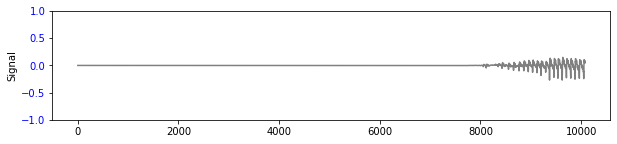


VAD output of this buffer
all_vad_preds[i] 0.93980706
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.94, 0.00


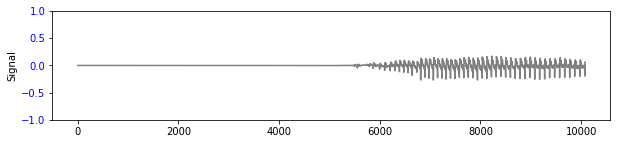


VAD output of this buffer
all_vad_preds[i] 0.9100966
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], 0.91, 0.16


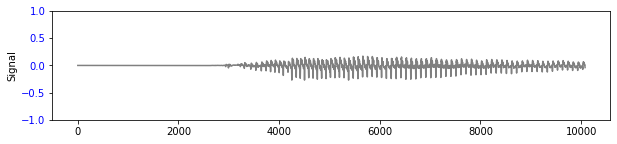


VAD output of this buffer
all_vad_preds[i] 0.71270895
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], 0.71, 0.32


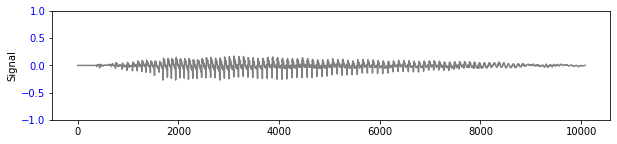


VAD output of this buffer
all_vad_preds[i] 0.89251095
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], 0.89, 0.48


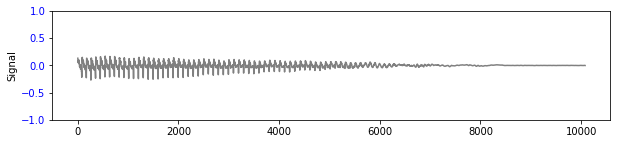


VAD output of this buffer
all_vad_preds[i] 0.90802115
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], 0.91, 0.64


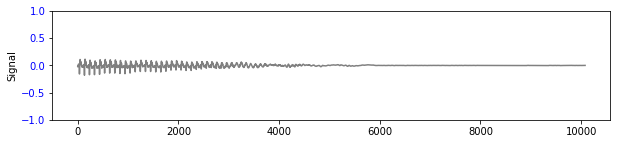


VAD output of this buffer
all_vad_preds[i] 0.837081
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], 0.84, 0.80


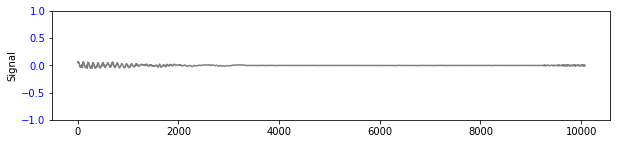


VAD output of this buffer
all_vad_preds[i] 0.8577405
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1], 0.86, 0.96


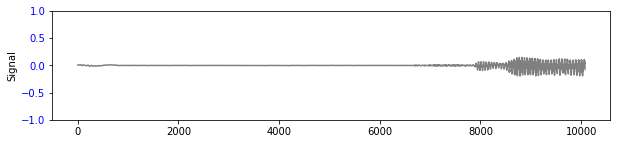


VAD output of this buffer
all_vad_preds[i] 0.9454449
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], 0.95, 1.12


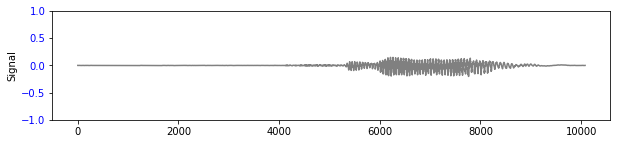


VAD output of this buffer
all_vad_preds[i] 0.9457057
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], 0.95, 1.28


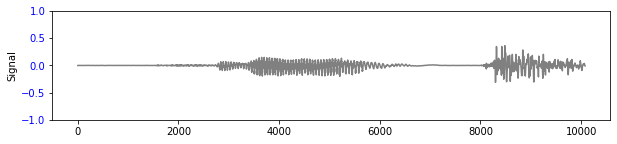


VAD output of this buffer
all_vad_preds[i] 0.8408526
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 0.84, 1.44
STOP at the end!  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1] 1 start:  0.48 end:  1.44


In [24]:
buffer_len_in_secs=0.63
# vad_context_window_len_in_secs=0.63 coarse grained
vad_decoder = VadChunkBufferDecoder(vad_model, chunk_len_in_secs=chunk_len_in_secs, buffer_len_in_secs=buffer_len_in_secs, patience=25)
streaming_vad_output, speech_segments = vad_decoder.transcribe_buffers(buffer_list, plot=True, threshold=0.5)

Time to evaluate our streaming inference on the whole long file that we created.

In [25]:
buffer_len_in_secs=0.63
buffer_len = int(sample_rate*buffer_len_in_secs)

sampbuffer = np.zeros([buffer_len], dtype=np.float32)
chunk_reader = AudioChunkIterator(samples, chunk_len_in_secs, sample_rate)
buffer_list = []
for chunk in chunk_reader:
    sampbuffer[:-chunk_len] = sampbuffer[chunk_len:]
    sampbuffer[-chunk_len:] = chunk
    buffer_list.append(np.array(sampbuffer))

vad_decoder = VadChunkBufferDecoder(vad_model, chunk_len_in_secs=chunk_len_in_secs, buffer_len_in_secs=buffer_len_in_secs, patience=25)
streaming_vad_output, speech_segments = vad_decoder.transcribe_buffers(buffer_list, plot=False)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 0.94, 0.00
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1], 0.91, 0.16
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1], 0.71, 0.32
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], 0.89, 0.48
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], 0.91, 0.64
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], 0.84, 0.80
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1], 0.86, 0.96
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], 0.95, 1.12
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], 0.95, 1.28
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1], 0.84, 1.44
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 0.90, 1.60

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0], 0.04, 94.24
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], 0.02, 94.40
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0], 0.90, 94.56
[0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1], 0.98, 94.72
[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1], 0.96, 94.88
[0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1], 0.93, 95.04
[0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1], 0.91, 95.20
[0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1], 0.89, 95.36
[0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1], 0.91, 95.52
[0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1], 0.92, 95.68
[0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1], 

In [26]:
audio, sample_rate = librosa.load(concat_audio_path,sr = 16000)
    
# ipd.display(ipd.Audio(audio, rate=sample_rate))

Length of VAD output:  1841.0625


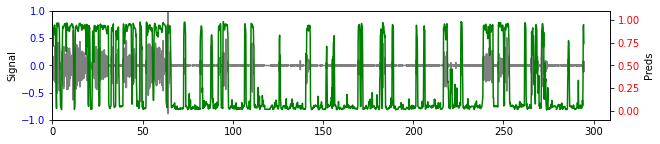

In [27]:
print("Length of VAD output: ", new_duration/chunk_len_in_secs)

plt.figure(figsize=[10, 2])
ax1 = plt.subplot()
ax1.plot(np.arange(len(audio))/16000, audio, 'gray')
ax1.tick_params(axis='y', labelcolor='b')
ax1.set_ylabel('Signal')
ax1.set_ylim([-1, 1])
ax1.set_xlim(0, )
ax2 = ax1.twinx()
ax2.plot(np.arange(len(streaming_vad_output))*0.16 , streaming_vad_output, 'g')
ax2.tick_params(axis='y', labelcolor='r')
ax2.set_ylabel('Preds')
ax2.set_ylim([-0.1, 1.1])
plt.show()

In [28]:
speech_segments = [list(i) for i in speech_segments]
speech_segments.sort(key=lambda x: x[0])
speech_segments

[[0.48, 69.92],
 [73.28, 78.08],
 [82.4, 87.2],
 [88.48, 101.6],
 [107.04, 116.0],
 [126.24, 130.56],
 [140.96, 147.2],
 [152.32, 160.48],
 [169.92, 176.32],
 [182.24, 193.28],
 [202.08, 210.72],
 [217.28, 225.76],
 [226.88, 231.52],
 [239.2, 257.44],
 [262.24, 277.44],
 [286.24, 290.72]]

In [29]:
for speech_segment in speech_segments: 
    
    print("Speech Segment:", speech_segment)
    audio_snipt, sample_rate = librosa.load(concat_audio_path,
                                      offset=speech_segment[0]-0.32,
                                      duration=speech_segment[1]-speech_segment[0],
                                      sr =16000)
    
    ipd.display(ipd.Audio(audio_snipt, rate=sample_rate))

Speech Segment: [0.48, 69.92]


Speech Segment: [73.28, 78.08]


Speech Segment: [82.4, 87.2]


Speech Segment: [88.48, 101.6]


Speech Segment: [107.04, 116.0]


Speech Segment: [126.24, 130.56]


Speech Segment: [140.96, 147.2]


Speech Segment: [152.32, 160.48]


Speech Segment: [169.92, 176.32]


Speech Segment: [182.24, 193.28]


Speech Segment: [202.08, 210.72]


Speech Segment: [217.28, 225.76]


Speech Segment: [226.88, 231.52]


Speech Segment: [239.2, 257.44]


Speech Segment: [262.24, 277.44]


Speech Segment: [286.24, 290.72]


## Original Streaming ASR

In [30]:
buffer_len_in_secs = 4
buffer_len = int(sample_rate*buffer_len_in_secs)
stride = 8
sample_rate = model.preprocessor._cfg['sample_rate'] 

sampbuffer = np.zeros([buffer_len], dtype=np.float32)
chunk_reader = AudioChunkIterator(samples, chunk_len_in_secs, sample_rate)

buffer_list = []
for chunk in chunk_reader:
    sampbuffer[:-chunk_len] = sampbuffer[chunk_len:]
    sampbuffer[-chunk_len:] = chunk
    buffer_list.append(np.array(sampbuffer))

asr_decoder = ChunkBufferDecoder(model, stride=stride, chunk_len_in_secs=chunk_len_in_secs, buffer_len_in_secs=buffer_len_in_secs )
streaming_asr_transcription = asr_decoder.transcribe_buffers(buffer_list, plot=False) + " "

wer = word_error_rate(hypotheses=[streaming_asr_transcription], references=[ref_transcript])
print(f"WER: {round(wer*100,2)}%")


WER: 40.21%


In [31]:
streaming_asr_transcription

"clint the wet is engagedzing day is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so are coming together for them they plan what uh hm her name is chris with the k they plan to get married into piga since most of their friends are there i suppose isn't that interesting and she said she started walking every morning before she doeses to work and hasn't lost the amount hasn't no it hasn't made an ounce of difference and uh so she says as soon as she's all through a pizza she's gonna start jaercise again just attending classses see umhum ho no but uhhuh oh no blam anarchy and nvs yeah yeah hm a bitid for tenn um yeah's yeah um i i think this is normal never is uh umhu oh yeah and pry things on yeah mhm h yeah hm that's yeah yeah yeah fat ones yeah i got the thinking my very best friends were always short and i don't know if it's because i was shortt myself and taer people intimidates me yeah that something like yeah

In [32]:
ref_transcript

'uh clint dewitt is engaged wedding date is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so things are coming together for them they plan what mhm her name is kris with a k they plan to get married in topeka since most of their friends are there i suppose but is not that interesting and she says she has started walking every morning before she goes to work and has not lost an ounce has not no it has not made an ounce of difference and uh so she says as soon as she is all through at pizza hut she is going to start jazzercise again just depending classes oh no uhhuh oh no bulimia and anorexia nervos uh a bid for attention i i think this is normal uh oh yeah and try things on yeah yeah yeah fat ones yeah i get to thinking my very best friends were always short and i do not know if it is because i was short myself taller people intimidated me yeah something like that yeah mhm yeah'

we can see there are some false alarm. 

## VAD before Streaming ASR¶

In [33]:
buffer_len_in_secs = 4
buffer_len = int(sample_rate*buffer_len_in_secs)
stride = 8
sample_rate = model.preprocessor._cfg['sample_rate'] 
final_streaming_asr_transcription = " "


for speech_segment in speech_segments: 
    samples = get_samples(concat_audio_path, 
                          offset=speech_segment[0]-0.32, 
                          duration=speech_segment[1] - speech_segment[0] + 2.16)  # add buffer_len_in_secs for streaming asr

    
    sampbuffer = np.zeros([buffer_len], dtype=np.float32)
    chunk_reader = AudioChunkIterator(samples, chunk_len_in_secs, sample_rate)

    buffer_list = []
    for chunk in chunk_reader:
        sampbuffer[:-chunk_len] = sampbuffer[chunk_len:]
        sampbuffer[-chunk_len:] = chunk
        buffer_list.append(np.array(sampbuffer))

    asr_decoder = ChunkBufferDecoder(model, stride=stride, chunk_len_in_secs=chunk_len_in_secs, buffer_len_in_secs=buffer_len_in_secs )
    streaming_asr_transcription = asr_decoder.transcribe_buffers(buffer_list, plot=False) + " "
    
    print(f"Speech Segment: {speech_segment}, {streaming_asr_transcription}")
    audio_snipt, sample_rate = librosa.load(concat_audio_path,
                                      offset=speech_segment[0],
                                      duration=speech_segment[1]-speech_segment[0],
                                      sr =16000)
    
    ipd.display(ipd.Audio(audio_snipt, rate=sample_rate))
    
    final_streaming_asr_transcription += streaming_asr_transcription

final_streaming_asr_transcription = final_streaming_asr_transcription[1:-1]
wer = word_error_rate(hypotheses=[final_streaming_asr_transcription], references=[ref_transcript])
print(f"WER: {round(wer*100,2)}%")

Speech Segment: [0.48, 69.92], clint the wet is engagedzing day is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so are coming together for them they plan what uh hm her name is chris with the k they plan to get married into pigas since most of their friends are there i suppose isn't that interesting and she said she started walking every morning before she doeses to work and hasn't lost the amount hasn't no it hasn't made an ounce of difference and uh so she says as soon as she's all through a pizza she's going gonna start jaercise again just attending classses 


Speech Segment: [73.28, 78.08], no but 


Speech Segment: [82.4, 87.2], uhhuh 


Speech Segment: [88.48, 101.6], oh no blam anarchy and nvs yeah 


Speech Segment: [107.04, 116.0], a bitid for tenn um yeah 


Speech Segment: [126.24, 130.56],  


Speech Segment: [140.96, 147.2], i i think this is normal never 


Speech Segment: [152.32, 160.48], umhu 


Speech Segment: [169.92, 176.32], oh yeah 


Speech Segment: [182.24, 193.28], prize thing is on yeah 


Speech Segment: [202.08, 210.72], yeah yeah 


Speech Segment: [217.28, 225.76], fat ones 


Speech Segment: [226.88, 231.52], no 


Speech Segment: [239.2, 257.44], i got the thinking my very best friends were always short and i don't know if it's because i was shortt myself and taer people intimidates me 


Speech Segment: [262.24, 277.44], yeah that something like yeah 


Speech Segment: [286.24, 290.72], umhu 


WER: 35.05%


In [34]:
buffer_len_in_secs = 4
buffer_len = int(sample_rate*buffer_len_in_secs)
stride = 8
sample_rate = model.preprocessor._cfg['sample_rate'] 
final_streaming_asr_transcription = " "


for speech_segment in speech_segments: 
    samples = get_samples(concat_audio_path, 
                          offset=speech_segment[0]-2.16, 
                          duration=speech_segment[1] - speech_segment[0] + 2.16)  # add buffer_len_in_secs for streaming asr

    
    sampbuffer = np.zeros([buffer_len], dtype=np.float32)
    chunk_reader = AudioChunkIterator(samples, chunk_len_in_secs, sample_rate)

    buffer_list = []
    for chunk in chunk_reader:
        sampbuffer[:-chunk_len] = sampbuffer[chunk_len:]
        sampbuffer[-chunk_len:] = chunk
        buffer_list.append(np.array(sampbuffer))

    asr_decoder = ChunkBufferDecoder(model, stride=stride, chunk_len_in_secs=chunk_len_in_secs, buffer_len_in_secs=buffer_len_in_secs )
    streaming_asr_transcription = asr_decoder.transcribe_buffers(buffer_list, plot=False) + " "
    
    print(f"Speech Segment: {speech_segment}, {streaming_asr_transcription}")
    audio_snipt, sample_rate = librosa.load(concat_audio_path,
                                      offset=speech_segment[0],
                                      duration=speech_segment[1]-speech_segment[0],
                                      sr =16000)
    
    ipd.display(ipd.Audio(audio_snipt, rate=sample_rate))
    
    final_streaming_asr_transcription += streaming_asr_transcription

final_streaming_asr_transcription = final_streaming_asr_transcription[1:-1]
wer = word_error_rate(hypotheses=[final_streaming_asr_transcription], references=[ref_transcript])
print(f"WER: {round(wer*100,2)}%")

[NeMo W 2021-10-19 11:46:36 nemo_logging:349] /home/fjia/anaconda3/envs/vad/lib/python3.7/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
      warnings.warn("PySoundFile failed. Trying audioread instead.")
    


Speech Segment: [0.48, 69.92], clint the wet is engagedzing day is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so are coming together for them they plan what uh hm her name is chris with the k they plan to get married into piga since most of their friends are there i suppose isn't that interesting and she said she started walking every morning before she doeses to work and hasn't lost the amount hasn't no it hasn't made an ounce of difference and uh so she says as soon as she's all through a pizza she's gonna start jaercise again just attending classses 


Speech Segment: [73.28, 78.08], ho no 


Speech Segment: [82.4, 87.2], uhhuh 


Speech Segment: [88.48, 101.6], oh no blam anarchy and nvs 


Speech Segment: [107.04, 116.0], hm a bit for tenn 


Speech Segment: [126.24, 130.56], yeah 


Speech Segment: [140.96, 147.2], i i think this is normal 


Speech Segment: [152.32, 160.48], mhm 


Speech Segment: [169.92, 176.32], oh yeah 


Speech Segment: [182.24, 193.28], pry things on yeah 


Speech Segment: [202.08, 210.72], yeah yeah 


Speech Segment: [217.28, 225.76], fat ones 


Speech Segment: [226.88, 231.52], yeah 


Speech Segment: [239.2, 257.44], i got the thinking my very best friends were always shortr and i don't know if it's because i was short myself and talller people intimidates me 


Speech Segment: [262.24, 277.44], yeah that' something like yeahep 


Speech Segment: [286.24, 290.72], mhm 


WER: 32.99%


In [35]:
final_streaming_asr_transcription

"clint the wet is engagedzing day is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so are coming together for them they plan what uh hm her name is chris with the k they plan to get married into piga since most of their friends are there i suppose isn't that interesting and she said she started walking every morning before she doeses to work and hasn't lost the amount hasn't no it hasn't made an ounce of difference and uh so she says as soon as she's all through a pizza she's gonna start jaercise again just attending classses ho no uhhuh oh no blam anarchy and nvs hm a bit for tenn yeah i i think this is normal mhm oh yeah pry things on yeah yeah yeah fat ones yeah i got the thinking my very best friends were always shortr and i don't know if it's because i was short myself and talller people intimidates me yeah that' something like yeahep mhm"

In [36]:
ref_transcript

'uh clint dewitt is engaged wedding date is still up in the air but most likely next summer after clint graduates they closed on their house a couple of weeks ago so things are coming together for them they plan what mhm her name is kris with a k they plan to get married in topeka since most of their friends are there i suppose but is not that interesting and she says she has started walking every morning before she goes to work and has not lost an ounce has not no it has not made an ounce of difference and uh so she says as soon as she is all through at pizza hut she is going to start jazzercise again just depending classes oh no uhhuh oh no bulimia and anorexia nervos uh a bid for attention i i think this is normal uh oh yeah and try things on yeah yeah yeah fat ones yeah i get to thinking my very best friends were always short and i do not know if it is because i was short myself taller people intimidated me yeah something like that yeah mhm yeah'

Go to examples/asr

!python vad_infer.py  --vad_model="vad_marblenet" --dataset="/home/fjia/code/NeMo-fei/examples/asr/chris.json" --out_dir='chris_s16' --time_length=0.63 --shift_length=0.16 --split_duration=1000